### Mainly the 3D plot at the end
Many of the other visuals (confusion matrices, feature importances, etc.) were done in the modeling notebook.

In [3]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

import plotly.figure_factory as ff
import plotly.graph_objs as go

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot


%matplotlib inline

from sklearn import datasets
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_validate, KFold, learning_curve, StratifiedKFold
from sklearn.metrics import accuracy_score, plot_confusion_matrix, confusion_matrix
from sklearn.metrics import roc_auc_score, roc_curve

from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler

import pickle

In [44]:
df3 = pd.read_csv('PhotoSpec3_rec.csv')

In [45]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


In [46]:
featuredf = df3.drop(['class','ObjID'], axis=1)

In [47]:
featurecols = list(featuredf)

In [48]:
featurecols

['ra',
 'dec',
 'u',
 'g',
 'r',
 'i',
 'z',
 'run',
 'camcol',
 'field',
 'redshift',
 'plate',
 'mjd',
 'fiberid',
 'log_redshift',
 'Distance',
 'x_coord',
 'y_coord',
 'z_coord']

In [49]:
bands=['u', 'g', 'r', 'i', 'z']

In [50]:
astrObjs = df3['class'].unique()
astrObjs

array(['STAR', 'GALAXY', 'QSO'], dtype=object)

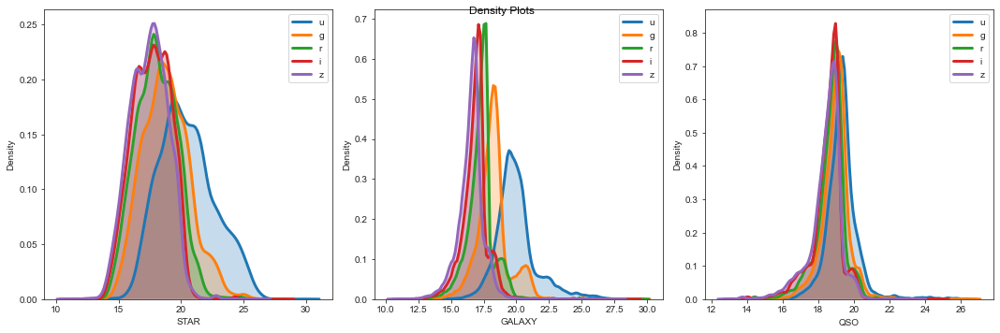

In [51]:
plt.figure(figsize=(15,5))
plt.suptitle('Density Plots')
sns.set_style("ticks")
for i in range(len(astrObjs)):
    plt.subplot(1, 3, i+1)
    for j in range(5):
        sns.distplot(df3[df3['class']==astrObjs[i]][bands[j]], hist = False, kde = True, kde_kws = {'shade': True, 'linewidth': 3}, label = bands[j])
    plt.legend()
    plt.xlabel(astrObjs[i])
    plt.ylabel('Density')
plt.tight_layout()

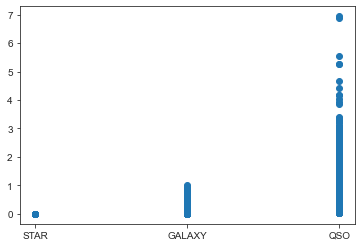

In [52]:
plt.scatter(df3['class'], df3['redshift'])

e:\Users\user\anaconda3\envs\metis\lib\site-packages\pandas\core\series.py:856: RuntimeWarning:

invalid value encountered in log10



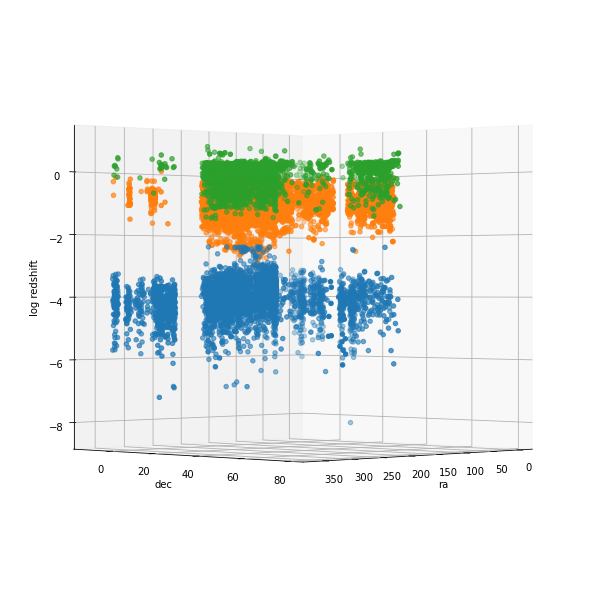

In [108]:

fig = plt.figure(figsize=(8,8))
ax = Axes3D(fig)
for obj in astrObjs:
    luminous = df3[df3['class'] == obj]
    ax.scatter(luminous['ra'], luminous['dec'], np.log10(luminous['redshift']))
ax.set_xlabel('ra')
ax.set_ylabel('dec')
ax.set_zlabel('log redshift')
ax.view_init(elev = 0, azim=45)
plt.show()

#### Couldn't quite figure out how to make a nice graph using polar coordinates
Kind of got a sense using right ascension and declination sort of as rectangular coordinates.

Text(0.5, 1.0, 'Equatorial coordinates')

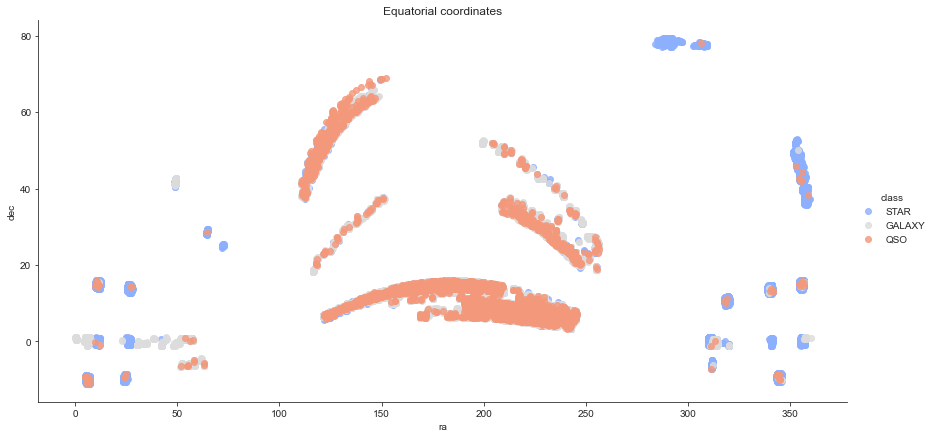

In [145]:
sns.lmplot(x='ra', y='dec', data=df3, hue='class', fit_reg=False, palette='coolwarm', height=6, aspect=2)
plt.title('Equatorial coordinates')

Text(0.5, 1.0, 'Equatorial coordinates')

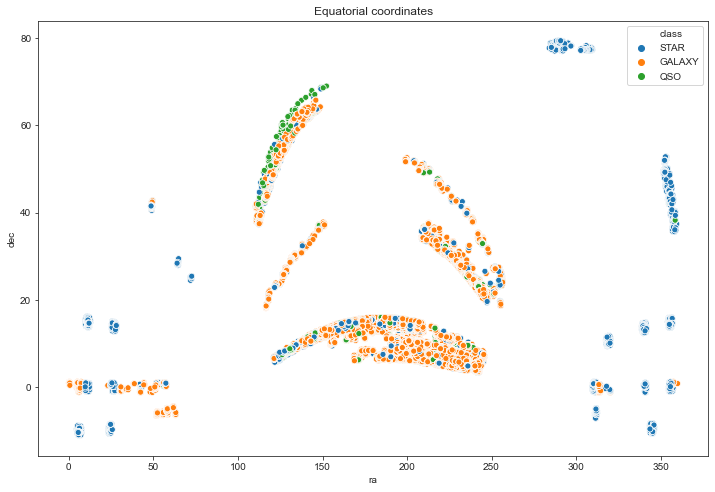

In [176]:
fig = plt.gcf()
fig.set_size_inches(12, 8)

sns.scatterplot(x='ra', y='dec', data=df3, hue='class')
plt.title('Equatorial coordinates')

#### Re-ran the model to try and get more visuals.
Next time, I should just pickle the model.

In [53]:
features = ['u', 'g', 'r', 'i', 'z', 'log_redshift']

In [54]:
X = df3[features]

In [55]:
y = df3['class']

In [56]:
X.head()

,u,g,r,i,z,log_redshift
0,16.54811,14.97662,14.29888,13.96458,13.82156,0.001638
1,19.84578,18.22822,17.41217,16.92843,16.57927,0.031207
2,17.90654,17.48691,17.39208,17.46770,17.31973,0.259359
3,20.24111,19.60741,19.25177,19.01723,18.92073,0.427337
4,19.36366,18.02443,17.68814,17.62313,17.29083,0.007425


In [57]:
#hold out 20% of the data for final testing
X, X_test, y, y_test = train_test_split(X, y, test_size=.2, random_state=10) 

In [58]:
#this helps with the way kf will generate indices below
X, y = np.array(X), np.array(y)

In [59]:
skf = StratifiedKFold(shuffle=True)

for train_ind, val_ind in skf.split(X,y):
    
    X_train, y_train = X[train_ind], y[train_ind]
    X_val, y_val = X[val_ind], y[val_ind]     
    
    nb=GaussianNB()
    nb.fit(X_train,y_train)
    
    dt=DecisionTreeClassifier()
    dt.fit(X_train,y_train)
    
    rf=RandomForestClassifier()
    rf.fit(X_train,y_train)
    
    
#     scaler = StandardScaler()
#     X_train_scaled = scaler.fit_transform(X_train)
#     X_val_scaled = scaler.transform(X_val)
    
    svm=SVC(probability=True)
    svm.fit(X_train,y_train)
    
    lr=LogisticRegression(solver='liblinear')
    lr.fit(X_train,y_train)
    
    knn=KNeighborsClassifier()
    knn.fit(X_train,y_train)
    
    
    models = {'Naive Bayes': nb, 'SVM':svm, 'Logistic':lr, 'KNN': knn, 'Decision Tree':dt, 'Random Forest':rf}
    results = {'Naive Bayes': [], 'SVM':[], 'Logistic':[], 'KNN': [], 'Decision Tree':[], 'Random Forest':[]}
    
    for name, model in models.items():
        results[name].append(accuracy_score(y_val, model.predict(X_val)))
        
for name, result in results.items():
    print(name)
    print(f'Mean Accuracy: {np.mean(result)}\n')
#     print('\n')
    
    
    

Naive Bayes
Mean Accuracy: 0.972375

SVM
Mean Accuracy: 0.83125

Logistic
Mean Accuracy: 0.895125

KNN
Mean Accuracy: 0.938375

Decision Tree
Mean Accuracy: 0.98625

Random Forest
Mean Accuracy: 0.990375



In [60]:
print("kNN confusion matrix: \n\n", confusion_matrix(y_test, knn.predict(X_test)))

kNN confusion matrix: 

 [[6908   12  243]
 [  58  552   10]
 [ 221    8 1988]]


In [61]:
y_test.value_counts()

GALAXY    7163
STAR      2217
QSO        620
Name: class, dtype: int64

In [62]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


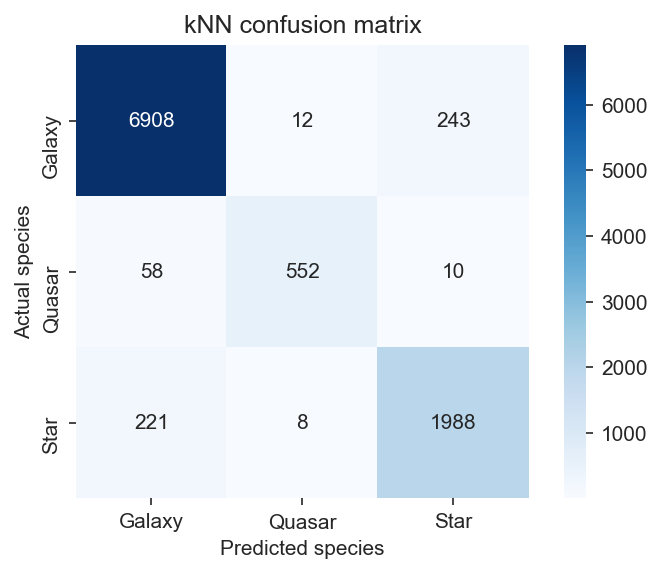

In [63]:
knn_confusion = confusion_matrix(y_test, knn.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(knn_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='g',
           xticklabels=['Galaxy', 'Quasar', 'Star'],
           yticklabels=['Galaxy', 'Quasar', 'Star'])

plt.xlabel('Predicted species')
plt.ylabel('Actual species')
plt.title('kNN confusion matrix');

#### Which observations were predicted incorrectly by Random Forest?

In [65]:
rf_pred = rf.predict(X_test)

In [66]:
rf_pred[0:10]

array(['GALAXY', 'GALAXY', 'STAR', 'GALAXY', 'STAR', 'GALAXY', 'GALAXY',
       'GALAXY', 'GALAXY', 'GALAXY'], dtype=object)

In [67]:
y_test.head()

27632    GALAXY
36119    GALAXY
4796       STAR
3648     GALAXY
24501      STAR
Name: class, dtype: object

In [68]:
mismatch = (y_test != rf_pred)

In [69]:
df3.iloc[X_test[mismatch].index]

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
16073,1237661069257605325,171.836646,14.261917,19.28094,18.86975,18.38478,18.10033,17.92038,3631,3,...,0.243457,1753,53383,72,GALAXY,0.094631,1041.997000,-999.649446,143.399101,256.701052
44904,1237663917885096038,143.697586,68.009171,18.17558,16.72479,15.98716,15.45969,15.19479,4294,5,...,0.070659,1878,54474,459,QSO,0.029651,302.421300,-91.263822,67.045862,280.418277
43697,1237662524696494283,195.298794,14.100703,20.28620,19.76985,19.02385,18.60087,18.25313,3970,2,...,0.233210,1771,53498,104,QSO,0.091037,998.138900,-933.758691,-255.426354,243.173496
33646,1237661976014815447,195.289577,7.592615,22.19761,21.11613,19.83813,19.66969,19.18909,3842,4,...,0.328268,1794,54504,480,QSO,0.123286,1404.988000,-1343.376889,-367.243682,185.639144
36609,1237662696495317775,226.506780,29.053729,24.24433,22.58131,20.57258,19.87236,19.35645,4010,2,...,0.621247,1844,54138,42,QSO,0.209849,2658.936000,-1599.776040,-1686.211756,1291.257987
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7620,1237652900771922183,54.953023,-6.340703,21.35351,20.25477,19.17466,18.85166,18.47351,1729,4,...,0.286162,1631,54469,464,QSO,0.109296,1224.773000,699.020876,996.565229,-135.264412
36084,1237662269146595634,225.270909,6.969051,18.48052,17.71451,16.96931,16.50315,16.28697,3910,6,...,0.168233,1815,53884,99,QSO,0.067529,720.037400,-502.986477,-507.765613,87.364434
17870,1237661070336983194,185.049916,15.508326,20.07318,19.52439,18.83970,18.38923,18.23187,3631,5,...,0.218901,1767,53436,382,GALAXY,0.085968,936.895200,-899.280098,-79.466316,250.505542
49550,1237649920574881888,11.528455,15.505314,21.73532,20.67213,20.23112,20.07948,19.92851,1035,5,...,-0.000401,1897,53242,505,GALAXY,-0.000174,-1.716031,-1.620217,-0.330475,-0.458743


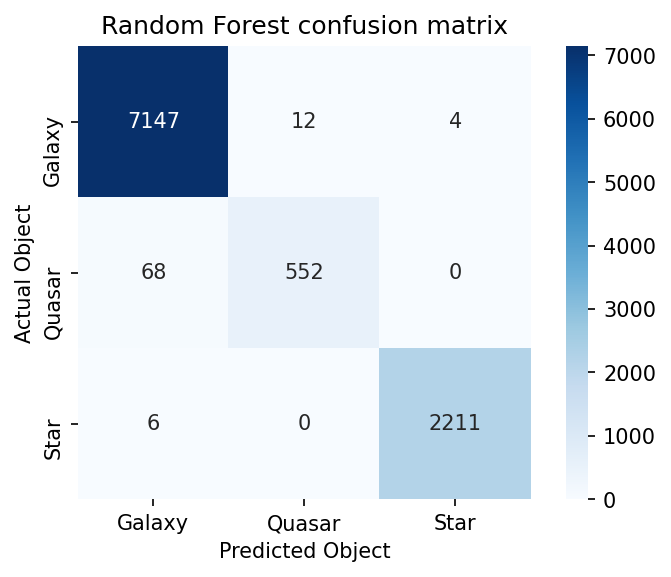

In [17]:
rf_confusion = confusion_matrix(y_test, rf.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(rf_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='g',
           xticklabels=['Galaxy', 'Quasar', 'Star'],
           yticklabels=['Galaxy', 'Quasar', 'Star'])

plt.xlabel('Predicted Object')
plt.ylabel('Actual Object')
plt.title('Random Forest confusion matrix');

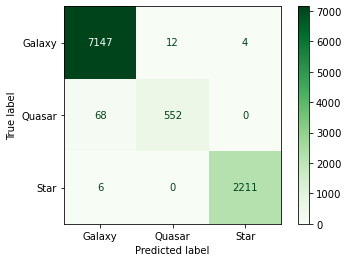

In [18]:
disp = plot_confusion_matrix(rf, X_test, y_test,
                                 display_labels=['Galaxy', 'Quasar', 'Star'],
                                 cmap=plt.cm.Greens, values_format = '.5g')

In [19]:
rf.feature_importances_

array([0.06459108, 0.03856106, 0.03557998, 0.07250716, 0.08073035,
       0.70803035])

#### Trying to look at the data one more time to do polar coordinate visuals

In [9]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


In [10]:
df_neg = df3[df3['Distance']<0]

In [11]:
df_neg['class'].value_counts()

STAR      7341
GALAXY       9
Name: class, dtype: int64

In [12]:
df3['class'].value_counts()

GALAXY    35958
STAR      10978
QSO        3064
Name: class, dtype: int64

In [13]:
df3[df3['Distance']<0]['class'].value_counts()

STAR      7341
GALAXY       9
Name: class, dtype: int64

In [14]:
stars = df3[df3['class']=='STAR']

In [15]:
stars['Distance'].describe()

count    10978.000000
mean        -0.498329
std          1.644320
min        -17.209240
25%         -1.090755
50%         -0.369004
75%          0.171682
max         17.775930
Name: Distance, dtype: float64

In [16]:
quasars = df3[df3['class']=='QSO']

In [17]:
quasars['Distance'].describe()

count     3064.00000
mean      4530.22564
std       2831.25422
min        144.19460
25%       2186.49075
50%       4585.61150
75%       6587.62875
max      29713.11000
Name: Distance, dtype: float64

In [18]:
galaxies = df3[df3['class']=='GALAXY']

In [19]:
galaxies['Distance'].describe()

count    35958.000000
mean       581.295970
std        434.573639
min         -3.566204
25%        309.970025
50%        461.220850
75%        690.218850
max       4271.332000
Name: Distance, dtype: float64

In [20]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


In [21]:
df3['ra'].describe()

count    50000.000000
mean       202.970942
std         66.361704
min          0.014610
25%        177.190898
50%        209.277849
75%        229.437360
max        359.994803
Name: ra, dtype: float64

In [22]:
df3['dec'].describe()

count    50000.000000
mean        13.418863
std         13.016039
min        -11.238099
25%          6.876130
50%          9.371594
75%         14.328001
max         79.438145
Name: dec, dtype: float64

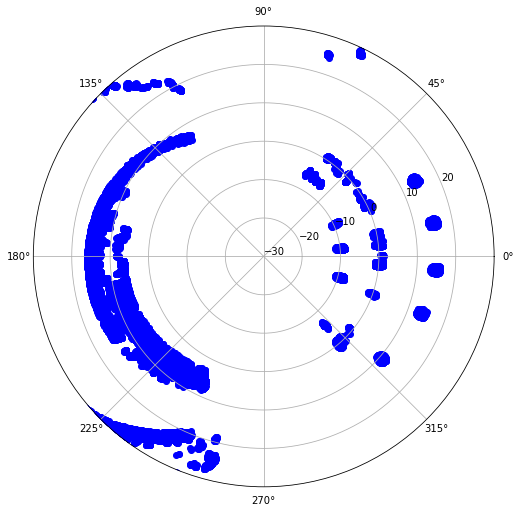

In [56]:
fig = plt.figure(figsize=[10,8])
ax = fig.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax.set_ylim(-30,30)
ax.set_yticks(np.arange(-30,30,10))
ax.scatter(df3['ra']/180*np.pi,df3['dec'],c ='b')


In [156]:
df3['class'].unique()

array(['STAR', 'GALAXY', 'QSO'], dtype=object)

In [157]:
np.where(df3['class']=='QSO')

(array([    2,     3,     7, ..., 49884, 49890, 49903], dtype=int64),)

STAR
GALAXY
QSO


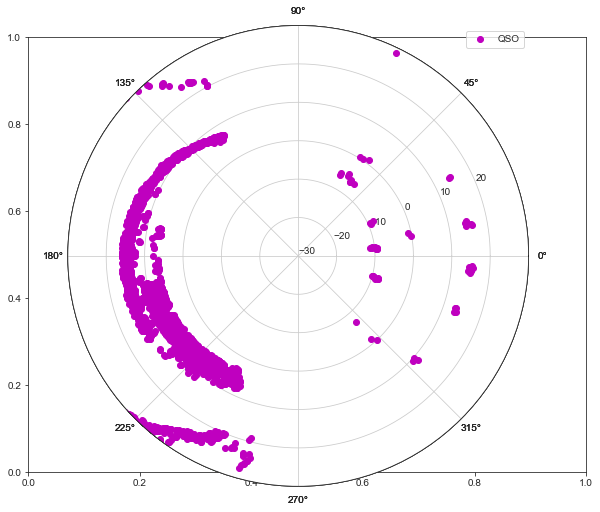

In [169]:
cdict = {'STAR':'y', 'GALAXY':'g', 'QSO':'m'}

fig, ax = plt.subplots(figsize=[10,8])
for g in df3['class'].unique():
    print(g)
    ix = np.where(df3['class']==g)
    ax = fig.add_axes([0.1,0.1,0.8,0.8],polar=True, label=g)
    ax.set_ylim(-30,30)
    ax.set_yticks(np.arange(-30,30,10))
    ax.scatter(df3.iloc[ix]['ra']/180*np.pi,df3.iloc[ix]['dec'],c =cdict[g], label=g)
ax.legend()


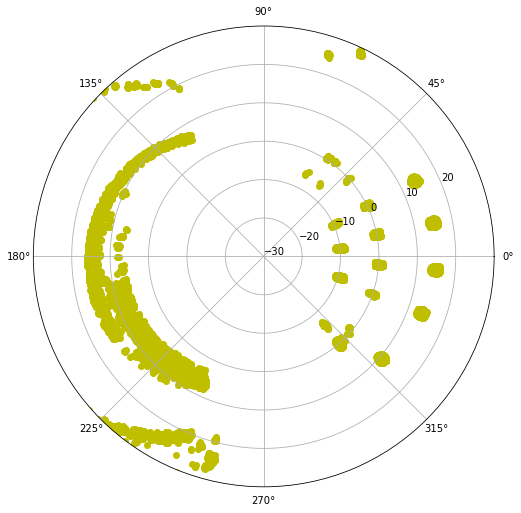

In [57]:
fig = plt.figure(figsize=[10,8])
ax = fig.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax.set_ylim(-30,30)
ax.set_yticks(np.arange(-30,30,10))
ax.scatter(stars['ra']/180*np.pi,stars['dec'],c ='y')


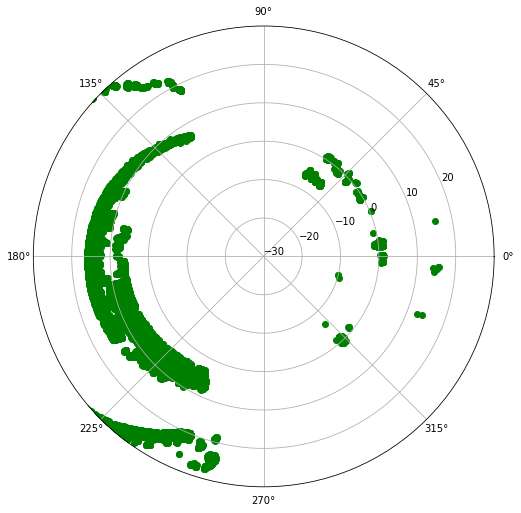

In [58]:
fig = plt.figure(figsize=[10,8])
ax = fig.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax.set_ylim(-30,30)
ax.set_yticks(np.arange(-30,30,10))
ax.scatter(galaxies['ra']/180*np.pi,galaxies['dec'],c ='g')


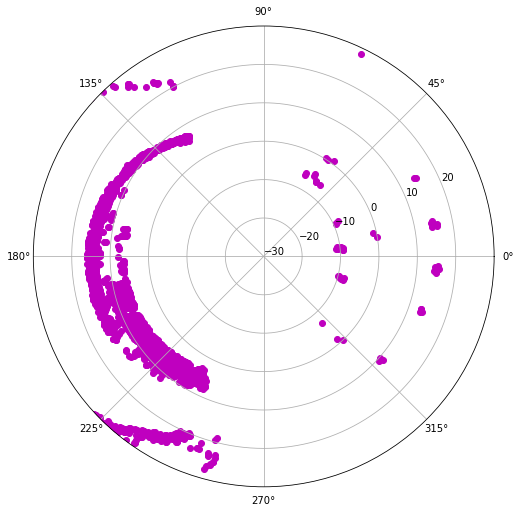

In [59]:
fig = plt.figure(figsize=[10,8])
ax = fig.add_axes([0.1,0.1,0.8,0.8],polar=True)
ax.set_ylim(-30,30)
ax.set_yticks(np.arange(-30,30,10))
ax.scatter(quasars['ra']/180*np.pi,quasars['dec'],c ='m')


### Equatorial to Cartesian Coordinates
https://www.jameswatkins.me/astronomy/2019/06/22/converting-equatorial-to-cartesian.html


We can calculate Cartesian coordinates as long as we have right ascension (α), declination (δ), and distance. Since celestial objects are in motion, it’s also important to use a time reference (epoch). Presently, the equatorial coordinates of celestial objects are usually given according to the J2000.0 epoch, which is January 1st 2000 12:00 Terrestrial Time (about 11:59 UTC). Right ascension is usually given in hour angles, declination is usually given in sexigesimal degrees (base-60, using minutes and seconds), and distance is usually given in parsecs (pc) or light-years (ly).


x = d * cos(δ) * cos(α)

y = d * cos(δ) * sin(α)

z = d * sin(δ)

#### This is a bit confusing because things are a bit out of order in this notebook. 
I added these Cartesian coordinates later, but when I re-ran the notebook, I used the latest version of the dataframe with the coordinates. 

In [72]:
df3['x_coord'] = df3['Distance']*np.cos(np.radians(df3['dec']))*np.cos(np.radians(df3['ra']))

In [74]:
df3['y_coord'] = df3['Distance']*np.cos(np.radians(df3['dec']))*np.sin(np.radians(df3['ra']))

In [75]:
df3['z_coord'] = df3['Distance']*np.sin(np.radians(df3['dec']))

In [76]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


In [78]:
df3.to_csv('PhotoSpec3_rec.csv', index=False)

In [27]:
df3 = pd.read_csv('PhotoSpec3_rec.csv')

In [28]:
df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
0,1237651274038771829,138.268193,60.244893,16.54811,14.97662,14.29888,13.96458,13.82156,1350,6,...,0.003779,1786,54450,43,STAR,0.001638,16.17476,-5.990624,5.343420,14.042192
1,1237651274038771878,138.327602,60.265790,19.84578,18.22822,17.41217,16.92843,16.57927,1350,6,...,0.074501,1786,54450,47,GALAXY,0.031207,318.86490,-118.131293,105.149102,276.881723
2,1237651540313440283,137.585001,60.037527,17.90654,17.48691,17.39208,17.46770,17.31973,1412,6,...,0.817015,1786,54450,82,QSO,0.259359,3496.82400,-1289.350884,1177.958241,3029.482921
3,1237651540313440527,137.624673,60.116218,20.24111,19.60741,19.25177,19.01723,18.92073,1412,6,...,1.675083,1786,54450,91,QSO,0.427337,7169.35600,-2638.856139,2407.523733,6216.102735
4,1237651540313440621,137.701070,60.056441,19.36366,18.02443,17.68814,17.62313,17.29083,1412,6,...,0.017243,1786,54450,83,GALAXY,0.007425,73.80074,-27.246544,24.791517,63.949634


In [29]:
df3[['x_coord', 'y_coord', 'z_coord']].describe()

,x_coord,y_coord,z_coord
count,50000.000000,50000.000000,50000.000000
mean,-477.800163,-164.799797,168.008970
std,969.195228,812.268582,494.737838
min,-28644.791229,-26571.520555,-2297.467673
25%,-501.849715,-277.505590,13.582955
50%,-271.072803,-86.756693,59.028248
75%,-62.528054,0.350280,139.083081
max,13942.499232,15376.607862,16481.837782


In [30]:
df3['redshift'].describe()

count    50000.000000
mean         0.162511
std          0.299555
min         -0.004021
25%          0.031013
50%          0.087946
75%          0.155727
max          6.942316
Name: redshift, dtype: float64

### Interactive 3D scatter plot
https://plotly.com/python/3d-scatter-plots/

#### Plotly express is nice and quick I didn't figure out how to tweak the details

In [31]:
import plotly.express as px

In [32]:
fig = px.scatter_3d(df3, x='x_coord', y='y_coord', z='z_coord', color='class', opacity=0.5)
fig.show()

In [40]:
fig = px.scatter_3d(df3.iloc[X_test.index], x='x_coord', y='y_coord', z='z_coord', color='class', opacity=0.5)
fig.show()

### Note that the distances don't make sense on the surfaceas they are in Mpc.
https://www.teachastronomy.com/textbook/The-Expanding-Universe/Relating-Redshift-and-Distance/

We can combine the Hubble relation and the definition of redshift to relate the distance of a galaxy to its redshift. First, rearrange the terms of the Hubble relation to calculate distance as d = v / H0. Then rearrange the terms of the redshift equation to get v = z c. Combining the two results gives

d = z c / H0

Again, this formula is only appropriate if the recession velocity is much less than the speed of light, or if z << 1. Knowing the value of the Hubble constant, redshift can be used as a distance indicator. This technique is a very powerful tool, since astronomers can measure redshifts of galaxies so faint that it is impossible to get more detailed information about them by other means.

#### More complicated plotly scatterplot

In [41]:

data = []
clusters = []
colors = ['rgb(228,26,28)','rgb(55,126,184)','rgb(77,175,74)'] # set our dot colors

for i in range(len(df3['class'].unique())): # allows us to split our data into three distinct groups
    name = df3['class'].unique()[i]
    color = colors[i]
    x = df3[ df3['class'] == name ]['x_coord']
    y = df3[ df3['class'] == name ]['y_coord']
    z = df3[ df3['class'] == name ]['z_coord']
    
    trace = dict(  # trace is how we "trace" or draw our data on the canvas
        name = name,
        x = x, y = y, z = z,
        type = "scatter3d",    
        mode = 'markers',
        marker = dict( size=3, color=color, line=dict(width=0), opacity=0.5 ) )
    data.append( trace )

layout = dict( # we modify our canvas here, including initial layout and styles
    width=800,
    height=550,
    autosize=False,
    title='G-S-O',
    scene=dict(
        xaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='X (MPc)',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#2f2f2f'),  # we can use hex, rgba, or other color variants
        ),
        yaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='Y (MPc)',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#4f4f4f'),
        ),
        zaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='Z (MPc)',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#7f7f7f'),
        ),
        aspectratio = dict( x=1, y=1, z=1 ), # we can compress large dimensions this way
        aspectmode = 'manual'        
    ),
)

fig = dict(data=data, layout=layout) # this finally compiles our figure

# run locally in notebook
iplot(fig)

# run on site, may need an account and access key, depending on usage
# url = py.plot(fig, filename='pandas-3d-iris', validate=False)

In [70]:
y_pred = rf.predict(X_test)

In [71]:
X_test.head()

,u,g,r,i,z,log_redshift
27632,20.26211,18.30658,17.51595,17.13637,16.88408,0.046451
36119,19.79777,18.08947,17.14395,16.66900,16.35429,0.062591
4796,20.02696,17.47033,16.26036,15.75846,15.45881,0.000028
3648,20.22307,18.69096,17.87653,17.46923,17.15980,0.040231
24501,17.13347,16.20972,15.88515,15.76302,15.72408,0.000044


In [72]:
X_test_df3 = df3.iloc[X_test.index]

In [73]:
X_test_df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
27632,1237662245521981462,209.303135,6.221153,20.26211,18.30658,17.51595,17.13637,16.88408,3905,2,...,0.112888,1805,53875,10,GALAXY,0.046451,483.158500,-418.853512,-235.079768,52.358136
36119,1237662685756391616,216.292638,34.157326,19.79777,18.08947,17.14395,16.66900,16.35429,4007,6,...,0.155025,1840,53472,545,GALAXY,0.062591,663.505300,-442.536653,-324.987955,372.536471
4796,1237652943703441741,339.369797,13.922314,20.02696,17.47033,16.26036,15.75846,15.45881,1739,4,...,0.000065,1892,53238,437,STAR,0.000028,0.278269,0.252774,-0.095164,0.066953
3648,1237655742946934970,229.101389,4.687801,20.22307,18.69096,17.87653,17.46923,17.15980,2391,2,...,0.097060,1833,54561,64,GALAXY,0.040231,415.418000,-271.073673,-312.951333,33.950577
24501,1237662198823780520,235.263484,7.727496,17.13347,16.20972,15.88515,15.76302,15.72408,3894,3,...,0.000102,1724,53859,193,STAR,0.000044,0.438430,-0.247550,-0.357022,0.058952


In [74]:
len(y_pred)

10000

In [75]:
X_test_df3['y_pred'] = y_pred

In [76]:
X_test_df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord,y_pred
27632,1237662245521981462,209.303135,6.221153,20.26211,18.30658,17.51595,17.13637,16.88408,3905,2,...,1805,53875,10,GALAXY,0.046451,483.158500,-418.853512,-235.079768,52.358136,GALAXY
36119,1237662685756391616,216.292638,34.157326,19.79777,18.08947,17.14395,16.66900,16.35429,4007,6,...,1840,53472,545,GALAXY,0.062591,663.505300,-442.536653,-324.987955,372.536471,GALAXY
4796,1237652943703441741,339.369797,13.922314,20.02696,17.47033,16.26036,15.75846,15.45881,1739,4,...,1892,53238,437,STAR,0.000028,0.278269,0.252774,-0.095164,0.066953,STAR
3648,1237655742946934970,229.101389,4.687801,20.22307,18.69096,17.87653,17.46923,17.15980,2391,2,...,1833,54561,64,GALAXY,0.040231,415.418000,-271.073673,-312.951333,33.950577,GALAXY
24501,1237662198823780520,235.263484,7.727496,17.13347,16.20972,15.88515,15.76302,15.72408,3894,3,...,1724,53859,193,STAR,0.000044,0.438430,-0.247550,-0.357022,0.058952,STAR


In [77]:
Xy = X_test_df3[['class', 'x_coord', 'y_coord', 'z_coord', 'y_pred']]

In [78]:
Xy

,class,x_coord,y_coord,z_coord,y_pred
27632,GALAXY,-418.853512,-235.079768,52.358136,GALAXY
36119,GALAXY,-442.536653,-324.987955,372.536471,GALAXY
4796,STAR,0.252774,-0.095164,0.066953,STAR
3648,GALAXY,-271.073673,-312.951333,33.950577,GALAXY
24501,STAR,-0.247550,-0.357022,0.058952,STAR
...,...,...,...,...,...
39432,GALAXY,-79.379304,-132.797039,68.450277,GALAXY
9566,GALAXY,-316.600102,143.757855,81.233152,GALAXY
8894,GALAXY,-743.059342,-102.668256,191.390754,GALAXY
39283,GALAXY,-351.104452,-416.601613,49.661569,GALAXY


In [79]:
Xy['match'] = Xy['class'] == Xy['y_pred']

In [80]:
Xy.head()

,class,x_coord,y_coord,z_coord,y_pred,match
27632,GALAXY,-418.853512,-235.079768,52.358136,GALAXY,True
36119,GALAXY,-442.536653,-324.987955,372.536471,GALAXY,True
4796,STAR,0.252774,-0.095164,0.066953,STAR,True
3648,GALAXY,-271.073673,-312.951333,33.950577,GALAXY,True
24501,STAR,-0.247550,-0.357022,0.058952,STAR,True


In [81]:
def mismatch(row):
    if row['class'] == row['y_pred']:
        return row['class']
    else:
        return 'MISMATCH'

In [82]:
Xy['match'] = Xy.apply(mismatch, axis=1)

In [83]:
Xy.head()

,class,x_coord,y_coord,z_coord,y_pred,match
27632,GALAXY,-418.853512,-235.079768,52.358136,GALAXY,GALAXY
36119,GALAXY,-442.536653,-324.987955,372.536471,GALAXY,GALAXY
4796,STAR,0.252774,-0.095164,0.066953,STAR,STAR
3648,GALAXY,-271.073673,-312.951333,33.950577,GALAXY,GALAXY
24501,STAR,-0.247550,-0.357022,0.058952,STAR,STAR


In [84]:
Xy['match'].value_counts()

GALAXY      7146
STAR        2210
QSO          555
MISMATCH      89
Name: match, dtype: int64

In [85]:
colors = {'GALAXY' : 'b',
          'STAR' : 'y',
          'QSO' : 'r', 
          'MISMATCH' : 'g'}

In [86]:
fig = px.scatter_3d(Xy, x='x_coord', y='y_coord', z='z_coord', color='match', opacity=0.5)
fig.show()

#### This ended up being the 3D visual that I used

In [88]:
def mismatch2(row):
    if row['class'] == row['y_pred']:
        return row['class']
    else:
        return row['class']+'->'+row['y_pred']

In [89]:
Xy['match2'] = Xy.apply(mismatch2, axis=1)

In [90]:
Xy.head()

,class,x_coord,y_coord,z_coord,y_pred,match,match2
27632,GALAXY,-418.853512,-235.079768,52.358136,GALAXY,GALAXY,GALAXY
36119,GALAXY,-442.536653,-324.987955,372.536471,GALAXY,GALAXY,GALAXY
4796,STAR,0.252774,-0.095164,0.066953,STAR,STAR,STAR
3648,GALAXY,-271.073673,-312.951333,33.950577,GALAXY,GALAXY,GALAXY
24501,STAR,-0.247550,-0.357022,0.058952,STAR,STAR,STAR


In [224]:
Xy['match2'].value_counts()

GALAXY          7147
STAR            2211
QSO              552
QSO->GALAXY       68
GALAXY->QSO       12
STAR->GALAXY       6
GALAXY->STAR       4
Name: match2, dtype: int64

In [91]:

data = []
clusters = []
colors = ['rgb(228,26,28)','rgb(55,126,184)','rgb(77,175,74)', 'rgb(0,0,0)', 'rgb(0,0,0)', 'rgb(0,0,0)', 'rgb(0,0,0)'] # set our dot colors

for i in range(len(Xy['match2'].unique())): # allows us to split our data into three distinct groups
    name = Xy['match2'].unique()[i]
    color = colors[i]
    x = Xy[ Xy['match2'] == name ]['x_coord']
    y = Xy[ Xy['match2'] == name ]['y_coord']
    z = Xy[ Xy['match2'] == name ]['z_coord']
    
    trace = dict(  # trace is how we "trace" or draw our data on the canvas
        name = name,
        x = x, y = y, z = z,
        type = "scatter3d",    
        mode = 'markers',
        marker = dict( size=3, color=color, line=dict(width=0), opacity=0.5 ) )
    data.append( trace )

layout = dict( # we modify our canvas here, including initial layout and styles
    width=900,
    height=700,
    autosize=False,
    title='Classification: Galaxies - Stars - Quasars',
    scene=dict(
        xaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='X',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#2f2f2f'),  # we can use hex, rgba, or other color variants
        ),
        yaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='Y',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#4f4f4f'),
        ),
        zaxis=dict(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=True,
            backgroundcolor='rgb(230, 230,230)',
            title='Z',  # set titles, very important
            titlefont=dict(
            family='Courier New',
            size=14,
            color='#7f7f7f'),
        ),
        aspectratio = dict( x=1, y=1, z=1 ), # we can compress large dimensions this way
        aspectmode = 'manual'        
    ),
)

fig = dict(data=data, layout=layout) # this finally compiles our figure


# run locally in notebook
iplot(fig)

# run on site, may need an account and access key, depending on usage
# url = py.plot(fig, filename='pandas-3d-iris', validate=False)

In [92]:
fig = px.scatter_3d(Xy, x='x_coord', y='y_coord', z='z_coord', color='match2', 
                    title='3D Plot of Stars, Galaxies, and Quasars', opacity=0.5, 
                   labels={'x_coord': 'X', 'y_coord': 'Y', 'z_coord': 'Z'})
fig.show()

In [230]:
Xy.head()

,class,x_coord,y_coord,z_coord,y_pred,match,match2
27632,GALAXY,-418.853512,-235.079768,52.358136,GALAXY,GALAXY,GALAXY
36119,GALAXY,-442.536653,-324.987955,372.536471,GALAXY,GALAXY,GALAXY
4796,STAR,0.252774,-0.095164,0.066953,STAR,STAR,STAR
3648,GALAXY,-271.073673,-312.951333,33.950577,GALAXY,GALAXY,GALAXY
24501,STAR,-0.247550,-0.357022,0.058952,STAR,STAR,STAR


In [232]:
Xy['match'].value_counts()

GALAXY      7147
STAR        2211
QSO          552
MISMATCH      90
Name: match, dtype: int64

In [238]:
mismatched_df3 = df3.iloc[Xy[Xy['match']=='MISMATCH'].index]

In [239]:
mismatched_df3.head()

,ObjID,ra,dec,u,g,r,i,z,run,camcol,...,redshift,plate,mjd,fiberid,class,log_redshift,Distance,x_coord,y_coord,z_coord
3157,1237661070857404472,146.338433,12.820280,18.03010,17.49923,16.87106,16.41127,16.17852,3631,6,...,0.137588,1742,53053,529,QSO,0.055985,588.8769,-477.918923,318.269337,130.668036
16073,1237661069257605325,171.836646,14.261917,19.28094,18.86975,18.38478,18.10033,17.92038,3631,3,...,0.243457,1753,53383,72,GALAXY,0.094631,1041.9970,-999.649446,143.399101,256.701052
44904,1237663917885096038,143.697586,68.009171,18.17558,16.72479,15.98716,15.45969,15.19479,4294,5,...,0.070659,1878,54474,459,QSO,0.029651,302.4213,-91.263822,67.045862,280.418277
43697,1237662524696494283,195.298794,14.100703,20.28620,19.76985,19.02385,18.60087,18.25313,3970,2,...,0.233210,1771,53498,104,QSO,0.091037,998.1389,-933.758691,-255.426354,243.173496
33646,1237661976014815447,195.289577,7.592615,22.19761,21.11613,19.83813,19.66969,19.18909,3842,4,...,0.328268,1794,54504,480,QSO,0.123286,1404.9880,-1343.376889,-367.243682,185.639144


In [240]:
mismatched_Xy = Xy[Xy['match']=='MISMATCH'].head()

In [241]:
mismatched_Xy.head()

,class,x_coord,y_coord,z_coord,y_pred,match,match2
3157,QSO,-477.918923,318.269337,130.668036,GALAXY,MISMATCH,QSO->GALAXY
16073,GALAXY,-999.649446,143.399101,256.701052,QSO,MISMATCH,GALAXY->QSO
44904,QSO,-91.263822,67.045862,280.418277,GALAXY,MISMATCH,QSO->GALAXY
43697,QSO,-933.758691,-255.426354,243.173496,GALAXY,MISMATCH,QSO->GALAXY
33646,QSO,-1343.376889,-367.243682,185.639144,GALAXY,MISMATCH,QSO->GALAXY


In [251]:
mismatched_Xy['match2'].value_counts()

QSO->GALAXY    4
GALAXY->QSO    1
Name: match2, dtype: int64